In this notebook we will use COMMOT to perform cell-cell communication analysis.

In [1]:
import os

import numpy as np
from scipy.stats import mannwhitneyu, false_discovery_control
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import plotnine
from plotnine import *

import anndata as ad
import scanpy as sc
import commot as ct

%matplotlib inline

import sys
sys.path.insert(0, "..")
from plot_settings import *

We load the AnnData files prepared in the first notebook.

In [2]:
adatas = {}
for f in os.scandir("adatas/"):
    adatas[os.path.splitext(f.name)[0]] = ad.read_h5ad(f.path)

We load the built-in COMMOT ligand-receptor database.

In [3]:
lr = ct.pp.ligand_receptor_database("CellChat", "human")

COMMOT requires a threshold distance, beyond which communication will not be considered. We first determine the minimum distance between two Visium spots.

In [4]:
from scipy.spatial.distance import pdist, squareform

l_min = squareform(pdist(adatas["3.4"].obsm["spatial"]))
np.fill_diagonal(l_min, np.inf)
l_min = l_min.min()

We now perform the spatial communication analysis, using 5 times the minimum inter-spot distance determined above as threshold.

In [5]:
for adata in adatas.values():
    ct.tl.spatial_communication(
        adata,
        database_name="CellChat",
        df_ligrec=lr,
        pathway_sum=True,
        dis_thr=5 * l_min,
        heteromeric=True,
    )

We retrieve the COMMOT results from the AnnData objects and aggregate them into a data frame for further analysis. Per-spot scores are summed up to yield per-sample scores.

In [6]:
scores = []
for sname, adata in adatas.items():
    pathways = adata.uns["commot-CellChat-info"]["df_ligrec"].pathway.unique()
    cscores = np.zeros((pathways.size,), dtype=np.float32)
    for i, p in enumerate(pathways):
        cscores[i] = adata.obsp[f"commot-CellChat-{p}"].sum()
    scores.append(
        pd.DataFrame(
            {
                "pathway": pathways,
                "score": cscores,
                "sample": sname,
                "nspots": adata.n_obs,
            }
        )
    )
scores = pd.concat(scores, axis=0).reset_index(drop=True)
scores["pathway"] = pd.Categorical(
    scores.pathway,
    categories=scores.sort_values("score", ascending=False).pathway.unique(),
    ordered=True,
)
scores["sample"] = pd.Categorical(scores["sample"])

We can now plot the pathway scores for each sample.

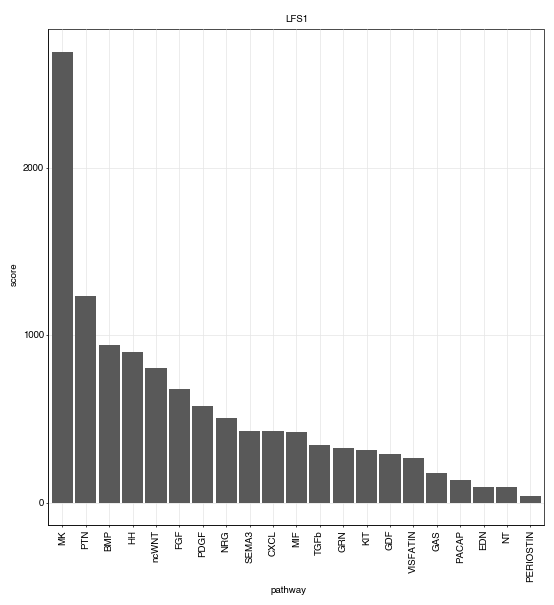

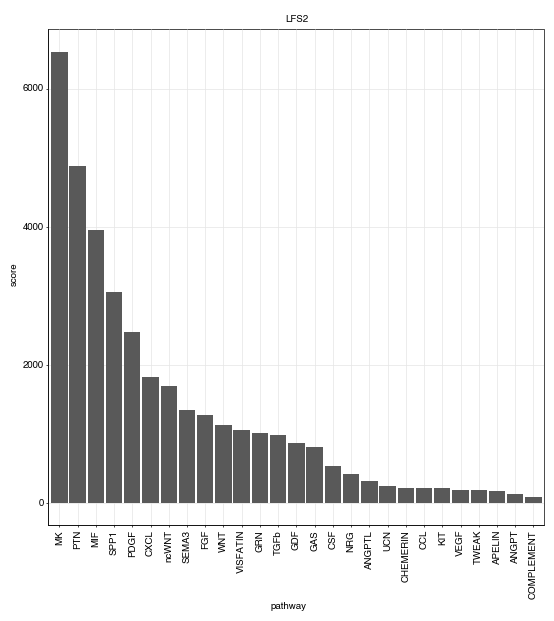

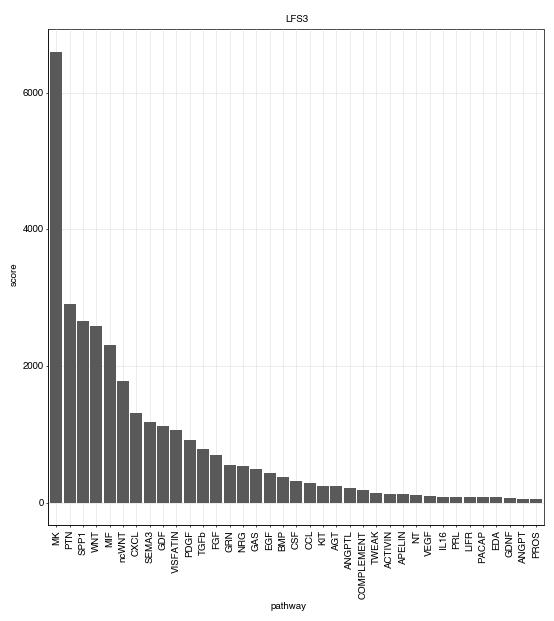

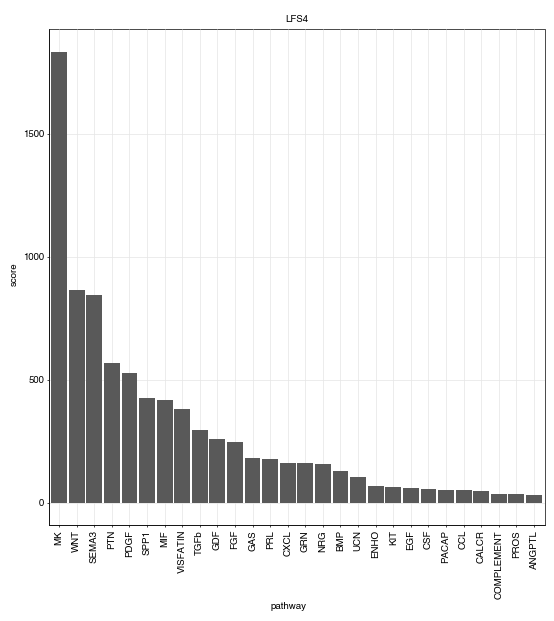

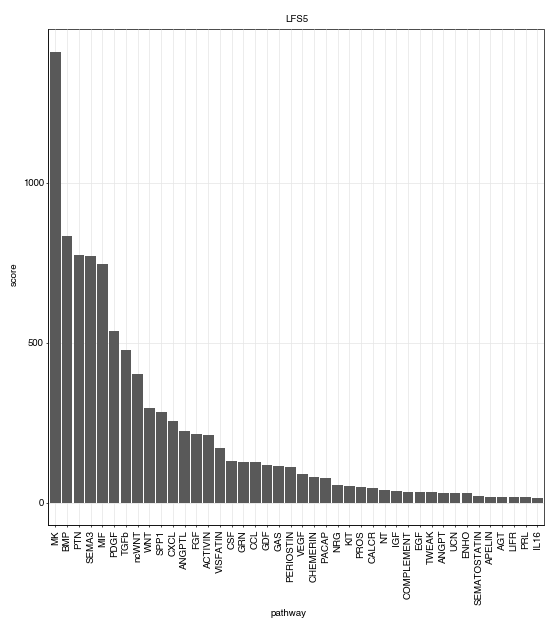

...

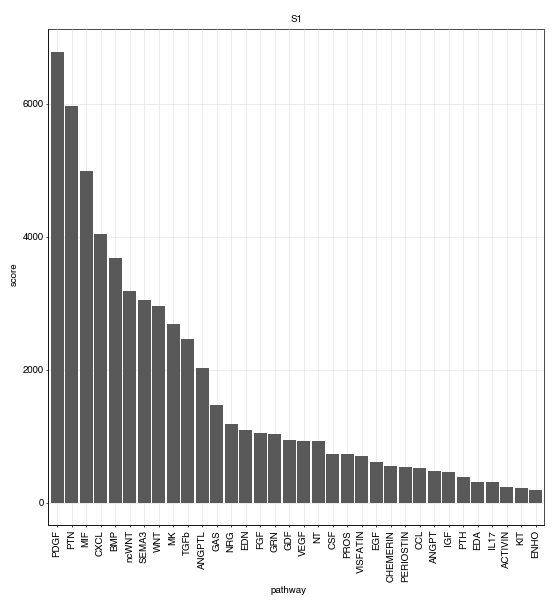

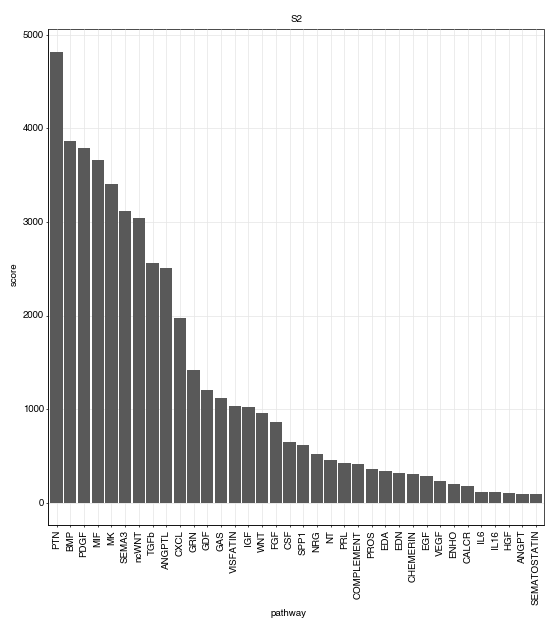

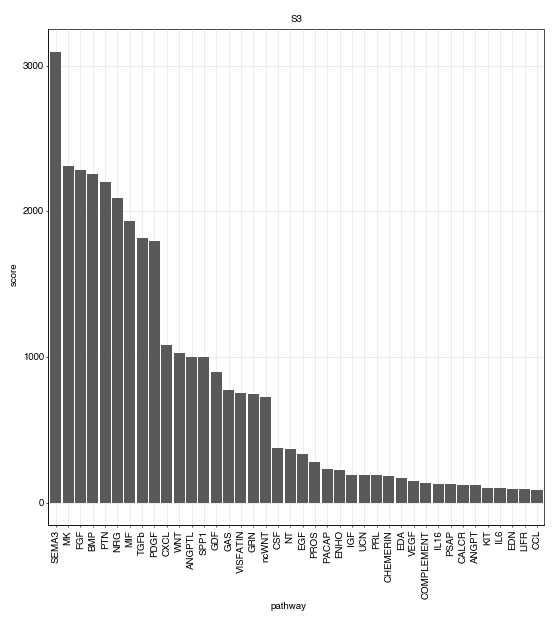

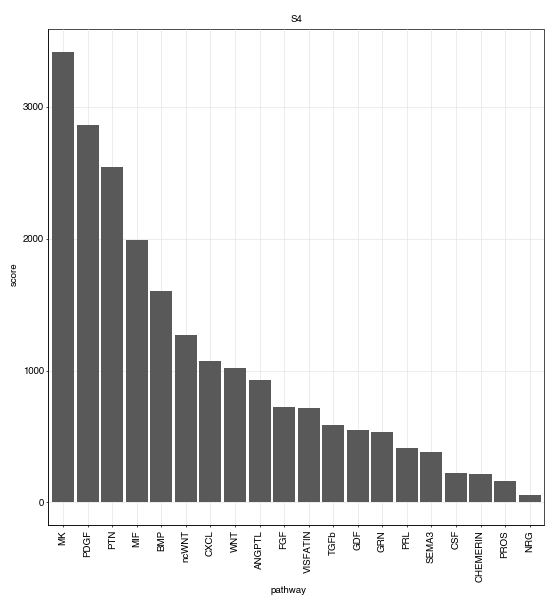

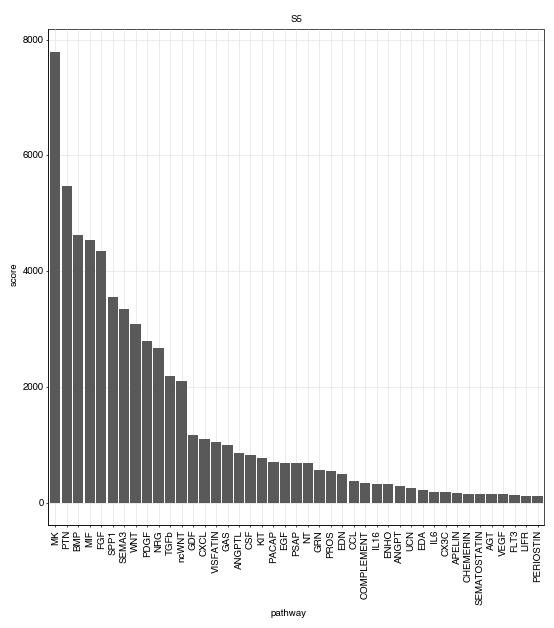

In [7]:
for sname, subdf in scores.groupby("sample"):
    subdf[
        "pathway"
    ] = subdf.pathway.cat.remove_unused_categories().cat.reorder_categories(
        new_categories=subdf.sort_values("score", ascending=False).pathway.to_list(),
        ordered=True,
    )
    print(
        ggplot(subdf, aes("pathway", "score"))
        + geom_bar(stat="identity")
        + facet_wrap("sample", ncol=4, scales="free", labeller=human_sample_map)
        + theme(
            axis_text_x=element_text(rotation=90),
            panel_spacing_x=0.5,
            panel_spacing_y=1,
        )
    )

To make the scores more comparable between samples, we divide the total score by the number of spots and plot the scores for the LFS8 sample to be included in the paper figures.

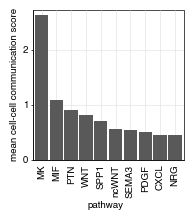

<ggplot: (8782267987098)>

In [8]:
p = (
    ggplot(
        scores[scores["sample"] == "3.4"]
        .sort_values("score", ascending=False)[:10]
        .assign(
            score=lambda x: x.score / x.nspots,
            pathway=lambda x: x.pathway.cat.remove_unused_categories().cat.reorder_categories(
                new_categories=x.pathway.to_list()
            ),
        )
        .reset_index(drop=True),
        aes("pathway", "score"),
    )
    + geom_bar(stat="identity")
    + scale_y_continuous(
        name="mean cell-cell communication score", expand=(0, 0, 0.04, 0)
    )
    + theme(
        axis_text_x=element_text(rotation=90),
        axis_ticks_major_x=element_blank(),
        aspect_ratio="auto",
        figure_size=(1.95, 1.95),
    )
)
p.save("figures/3D_barplot.svgz")
p

COMMOT can also determine the communication direction: Which spots secrete a signaling molecule and which spots bind it. We run this analsyis and plot the results for the 5 highest-scoring pathways.

In [9]:
for sname, adata in adatas.items():
    for p in scores[scores["sample"] == sname].pathway.unique():
        ct.tl.communication_direction(adata, database_name="CellChat", pathway_name=p)

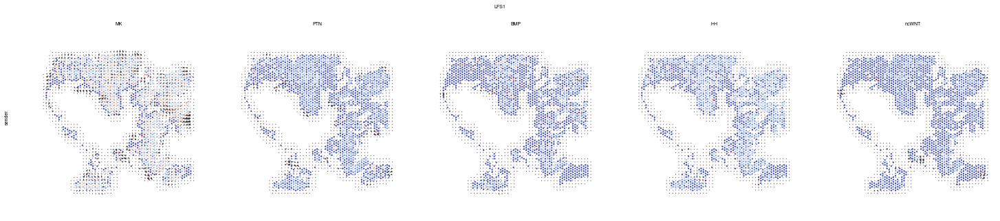

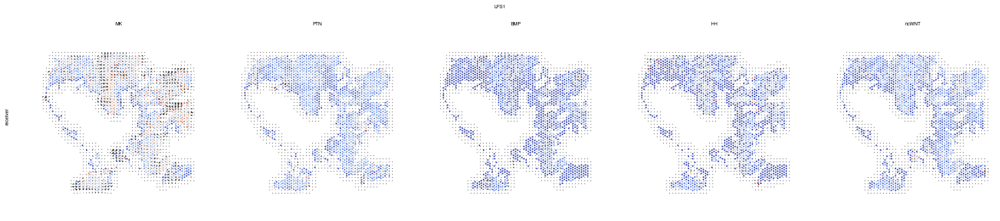

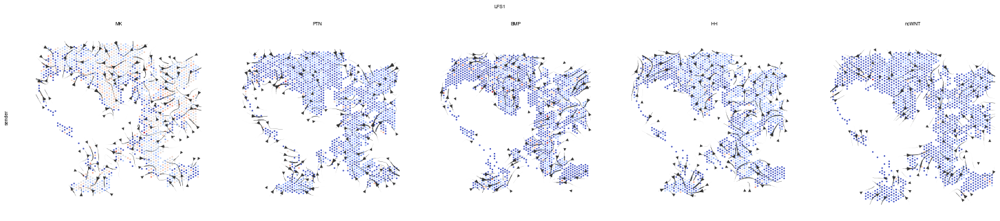

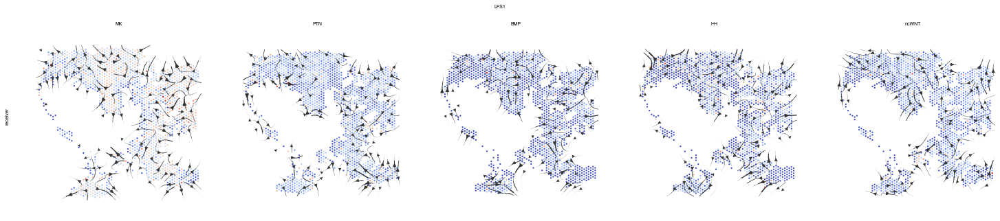

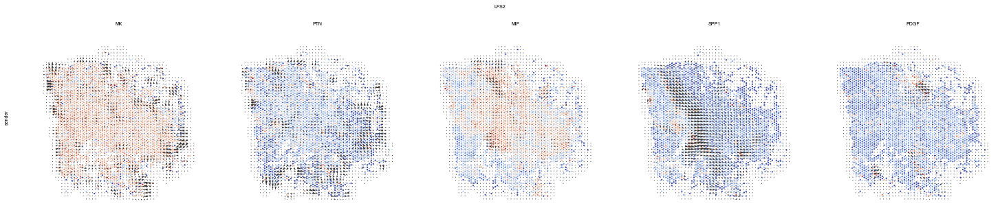

...

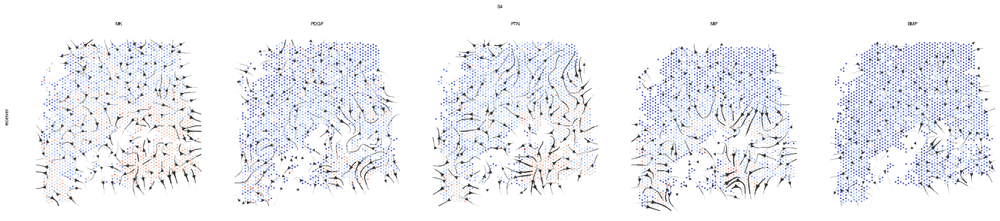

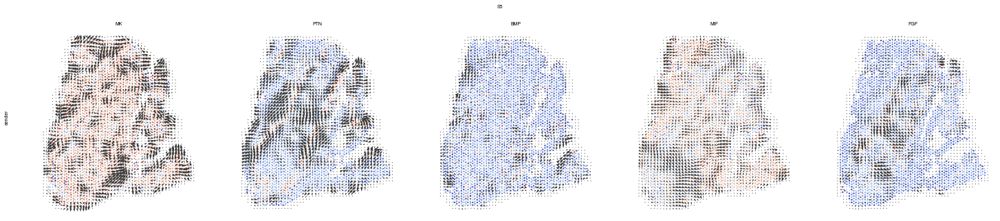

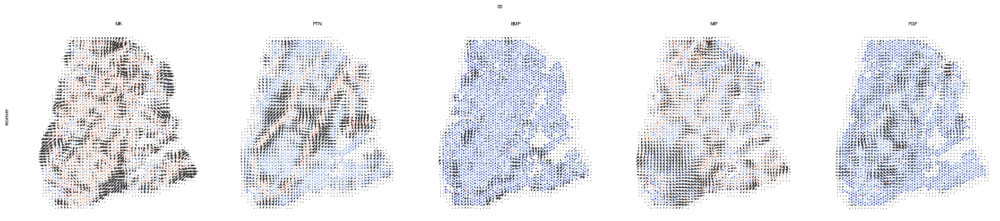

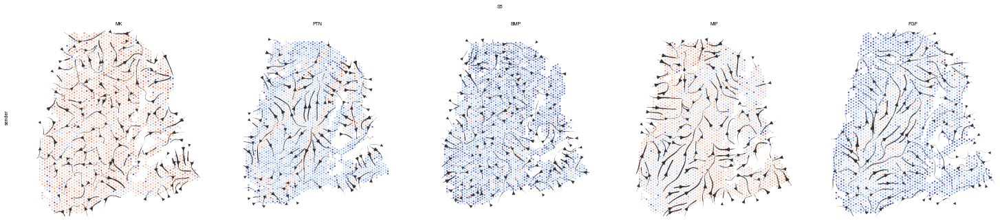

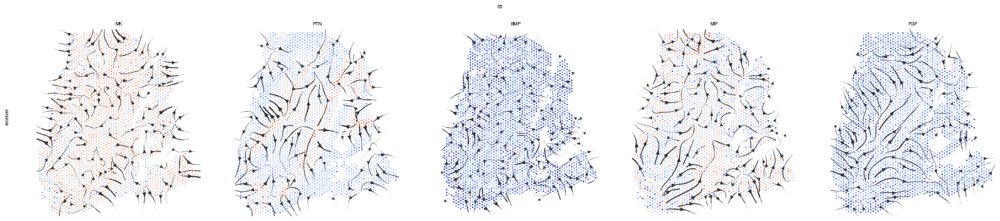

In [10]:
n_top_pathways = 5

for sname in sorted(adatas.keys()):
    adata = adatas[sname].copy()
    adata.obsm["spatial"] = (
        adata.obsm["spatial"] / 300
    )  # grid plotting is sensitive to coordinate scaling
    pathways = (
        scores[scores["sample"] == sname]
        .sort_values("score", ascending=False)
        .pathway[:n_top_pathways]
        .to_list()
    )
    for method in ("grid", "stream"):
        for summary in ("sender", "receiver"):
            fig = plt.figure(figsize=(25, 5))
            for i, p in enumerate(pathways):
                ax = fig.add_subplot(1, n_top_pathways, i + 1)
                ct.pl.plot_cell_communication(
                    adata,
                    database_name="CellChat",
                    pathway_name=p,
                    summary=summary,
                    ndsize=5,
                    plot_method=method,
                    ax=ax,
                )
                ax.set_title(p)
                ax.invert_yaxis()
            fig.suptitle(human_sample_map[sname])
            fig.text(0.1, 0.5, summary, rotation=90)

We plot the communication directions for the LFS8 sample to be included in the figures.

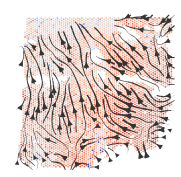

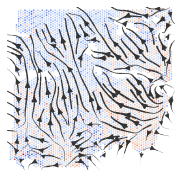

In [11]:
with mpl.rc_context({"figure.figsize": (3, 3)}):
    adata = adatas["3.4"].copy()
    adata.obsm["spatial"] = adata.obsm["spatial"] / 300
    ct.pl.plot_cell_communication(
                    adata,
                    database_name="CellChat",
                    pathway_name="MK",
                    summary="sender",
                    ndsize=3,
                    plot_method="stream"
                )
    plt.gca().invert_yaxis()
    plt.savefig("figures/3D_streamplot.svgz")
    
    ct.pl.plot_cell_communication(
                    adata,
                    database_name="CellChat",
                    pathway_name="MK",
                    summary="receiver",
                    ndsize=3,
                    plot_method="stream"
                )
    plt.gca().invert_yaxis()
    plt.savefig("figures/3D_streamplot_receiver.svgz")

We now plot the mean pathway scores separated by tumor type.

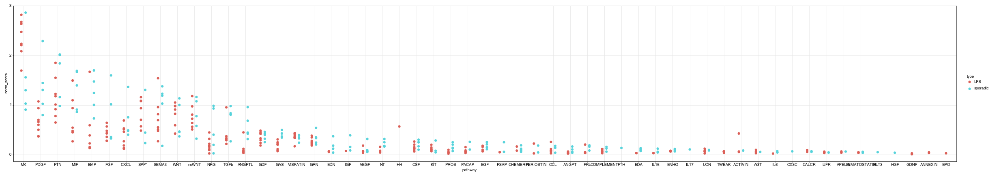

<ggplot: (8782268174877)>

In [12]:
scores = scores.assign(
    norm_score=scores.score / scores.nspots,
    type=lambda x: np.where(x["sample"].str[0].astype(int) <= 3, "LFS", "sporadic"),
)
(
    ggplot(scores, aes("pathway", "norm_score", color="type"))
    + geom_jitter(position=position_dodge(width=0.5))
    + theme(aspect_ratio="auto", figure_size=(30, 5))
)

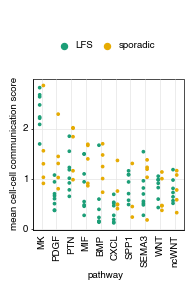

<ggplot: (8782271384213)>

In [13]:
p = (
    ggplot(
        scores[
            scores.pathway.isin(
                scores.groupby("pathway")["score"]
                .agg("sum")
                .sort_values(ascending=False)[:10]
                .index
            )
        ],
        aes("pathway", "norm_score", color="type"),
    )
    + geom_jitter(size=0.5, position=position_dodge(width=0.5))
    + guides(color=guide_legend(override_aes={"size": 2}))
    + lfs_sporadic_color_scale
    + labs(y="mean cell-cell communication score", color="")
    + theme(
        axis_text_x=element_text(rotation=90),
        axis_ticks_major_x=element_blank(),
        figure_size=(1.95, 1.95),
        legend_position="top"
    )
)
p.save("figures/3E_dotplot.svgz")
p

In [14]:
scores[
    scores.pathway.isin(
        set(
            scores.groupby(["pathway"])
            .apply(lambda df: df.type.nunique())
            .rename("ntypes")
            .reset_index()
            .query("ntypes > 1")
            .pathway
        )
    )
].groupby("pathway", observed=True).apply(
    lambda df: mannwhitneyu(
        df.norm_score[df.type == "LFS"].to_numpy(),
        df.norm_score[df.type != "LFS"].to_numpy(),
    ).pvalue
).rename(
    "pval"
).reset_index().assign(
    padj=lambda df: false_discovery_control(df.pval, method="bh")
)

,pathway,pval,padj
0,MK,0.093240,0.524476
1,PDGF,0.010878,0.159091
2,PTN,0.170940,0.549451
3,MIF,0.170940,0.549451
4,BMP,0.030303,0.227273
5,FGF,0.832945,1.000000
6,CXCL,0.170940,0.549451
7,SPP1,0.516667,0.775000
8,SEMA3,0.284382,0.639860
9,WNT,0.755051,1.000000


We now calculate scores not per pathway, as above, but per ligand-receptor pair, and write out the results to disk.

In [15]:
scores_ligrec = []
for sname, adata in adatas.items():
    ligrec = adata.uns["commot-CellChat-info"]["df_ligrec"]
    cscores = np.zeros((ligrec.shape[0],), dtype=np.float32)
    for i in range(ligrec.shape[0]):
        cscores[i] = adata.obsp[
            f"commot-CellChat-{ligrec['ligand'][i]}-{ligrec['receptor'][i]}"
        ].sum()
    scores_ligrec.append(
        pd.DataFrame(
            {
                "ligand": ligrec.ligand,
                "receptor": ligrec.receptor,
                "score": cscores,
                "sample": sname,
                "nspots": adata.n_obs,
            }
        )
    )
scores_ligrec = pd.concat(scores_ligrec, axis=0).reset_index(drop=True)
scores_ligrec["ligand"] = pd.Categorical(scores_ligrec.ligand)
scores_ligrec["receptor"] = pd.Categorical(scores_ligrec.receptor)
scores_ligrec["sample"] = pd.Categorical(scores_ligrec["sample"])
scores_ligrec["norm_score"] = scores_ligrec.score / scores_ligrec.nspots

In [16]:
scores_ligrec = (
    scores_ligrec.groupby("sample", as_index=False)
    .apply(lambda x: x.sort_values("norm_score", ascending=False))
    .reset_index(drop=True)
    .assign(
        type=lambda x: np.where(x["sample"].str[0].astype(int) <= 3, "LFS", "sporadic")
    )
)
scores_ligrec.to_csv("commot_ligand-receptor.csv")

We plot some UMAPs using data from the Parra et al. paper. First for the snRNAseq dataset.

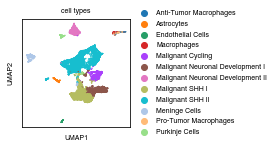

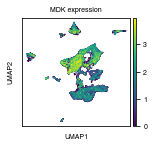

In [17]:
nuclei = ad.read_h5ad("../../adata_nuclei_Celltype_subclustered.h5ad")

with mpl.rc_context({"figure.figsize": (4, 2)}):
    for var, title in zip(("Cell_types", "MDK"), ("cell types", "MDK expression")):
        sc.pl.umap(nuclei, color=var, title=title, wspace=2, show=False)
        plt.gca().set_box_aspect(1)
        plt.savefig(f"figures/3G_umap_{var}.svgz")
        plt.show()

Now for the scRNAseq PDX dataset.

In [18]:
pdx = ad.read_h5ad("../../PDX_Celltype_scanpy.h5ad")

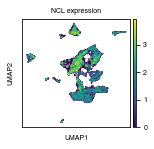

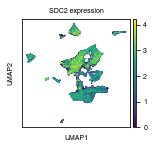

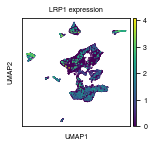

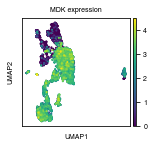

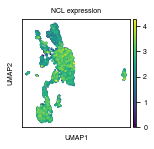

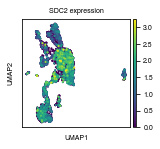

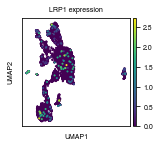

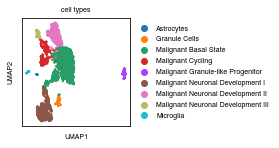

In [19]:
with mpl.rc_context({"figure.figsize": (4, 2)}):
    for gene in ("NCL", "SDC2", "LRP1"):
        sc.pl.umap(nuclei, color=gene, title=f"{gene} expression", wspace=2, show=False)
        plt.gca().set_box_aspect(1)
        plt.savefig(f"figures/SX_umap_{gene}_nuclei.svgz")
    for gene in ("MDK", "NCL", "SDC2", "LRP1"):
        sc.pl.umap(pdx, color=gene, title=f"{gene} expression", wspace=2, show=False)
        plt.gca().set_box_aspect(1)
        plt.savefig(f"figures/SX_umap_{gene}_pdx.svgz")
    
    sc.pl.umap(pdx, color="Cell_types", title="cell types", wspace=2, show=False)
    plt.gca().set_box_aspect(1)
    plt.savefig("figures/SX_umap_celltypes_pdx.svgz")